In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
filename = "health_data.csv"
filepath = os.path.join("data", filename)
heart_data = pd.read_csv(filepath_or_buffer=filepath)
print("Printing the first five(5) rows of the data \n")
display(heart_data.head(5))

Printing the first five(5) rows of the data 



,Unnamed: 0,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,0.0,18393.0,1,168.0,62.0,110.0,80.0,0,0,0,0,1,0
1,1,1.0,20228.0,0,156.0,85.0,140.0,90.0,2,0,0,0,1,1
2,2,2.0,18857.0,0,165.0,64.0,130.0,70.0,2,0,0,0,0,1
3,3,3.0,17623.0,1,169.0,82.0,150.0,100.0,0,0,0,0,1,1
4,4,4.0,17474.0,0,156.0,56.0,100.0,60.0,0,0,0,0,0,0


* Age | Objective Feature | age | int (days)

* Height | Objective Feature | height | int (cm) |

* Weight | Objective Feature | weight | float (kg) |

* Gender | Objective Feature | gender | categorical code |

* Systolic blood pressure | Examination Feature | ap_hi | int |

* Diastolic blood pressure | Examination Feature | ap_lo | int |

* Cholesterol | Examination Feature | cholesterol | 1: normal, 2: above normal, 3: well above normal |

* Glucose | Examination Feature | gluc | 1: normal, 2: above normal, 3: well above normal |

* Smoking | Subjective Feature | smoke | binary |

* Alcohol intake | Subjective Feature | alco | binary |

* Physical activity | Subjective Feature | active | binary |

* Presence or absence of cardiovascular disease | Target Variable | cardio | binary |

In [3]:
#we shall look at the number of records and number of columns we have 

print(heart_data.shape)

(70000, 14)


In [4]:
# A quick overview of our dataset

heart_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Unnamed: 0   70000 non-null  int64  
 1   id           70000 non-null  float64
 2   age          70000 non-null  float64
 3   gender       70000 non-null  int64  
 4   height       70000 non-null  float64
 5   weight       70000 non-null  float64
 6   ap_hi        70000 non-null  float64
 7   ap_lo        70000 non-null  float64
 8   cholesterol  70000 non-null  int64  
 9   gluc         70000 non-null  int64  
 10  smoke        70000 non-null  int64  
 11  alco         70000 non-null  int64  
 12  active       70000 non-null  int64  
 13  cardio       70000 non-null  int64  
dtypes: float64(6), int64(8)
memory usage: 7.5 MB


### Inference:

> Alot of work has to be done, from EDA to feature engineering to feature selection
> But just before going into all of those, we can clearly see some redundant and some needless features just like ```Id and Unnamed: 0```

In [5]:
heart_data = heart_data.drop(columns=['id', "Unnamed: 0"], axis=1)

In [6]:
##Let's convert the feature AGE from being number of days to years, so we can relate well
heart_data["age"] = heart_data["age"] // 365

#### View ```Age``` Distribution

<Figure size 800x600 with 0 Axes>

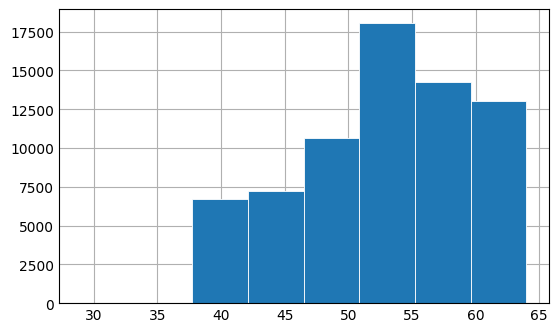

In [7]:
import matplotlib as mpl
plt.figure(figsize=(8,6))
plt.style.use('_mpl-gallery')
fig, ax = plt.subplots(figsize=(5,3))

ax.hist(x=heart_data['age'], bins=8, linewidth=0.6, edgecolor='white')
plt.show()

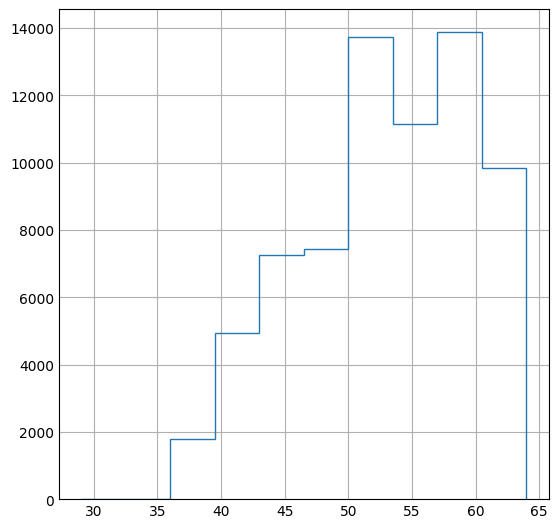

In [8]:
plt.figure(figsize=(5,5))
counts, bins = np.histogram(heart_data['age'])
plt.stairs(counts, bins)

### Inference: 
__From the above visuals, we can see that the minimum age is 36, while the maximum age is 64, thus we can know the range of people recorded__

In [9]:
# Age range is:
print(f"The age range is {heart_data['age'].max() - heart_data['age'].min()}")
print(f"Maximum  age is {heart_data['age'].max()}")
print(f"Minimum  age is {heart_data['age'].min()}")

The age range is 35.0
Maximum  age is 64.0
Minimum  age is 29.0


In [10]:
# Now this is really strange, but what happened???
# we should have seen that the minimum age we have is 29, meanwhile our histogram plot has started from 36, does it mean that there 
#is an outlier??? Let's confirm, there are multiple ways of confirming, one popular way of confirming is the use of boxplot

Box plot for 'Age'


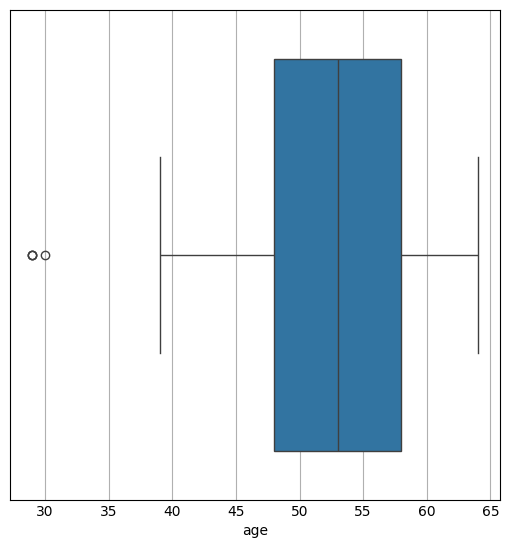

In [10]:
plt.figure(figsize=(5,5))
print("Box plot for 'Age'")
sns.boxplot(data=heart_data, x="age")
plt.show()

#### Our guess is absolutely right, and this should be handled 

> * since we might have multiple cases of outliers, we shall write our own custom function to address the case of outliers in any column or feature

In [11]:
def outlier_handler(df, col:str):
    Q1 = np.percentile(df[col], 25)
    Q3 = np.percentile(df[col], 75)

    IQR = Q3 - Q1

    #Lower bound and upper bound
    lower_bound = Q1 - (1.5 * IQR)
    upper_bound = Q3 + (1.5 * IQR)

    df[col] = df[col][(df[col] >= lower_bound) & (df[col] <= upper_bound)]
    df[col] = df[col].fillna(df[col].mean())
    return df

In [12]:
heart_data = outlier_handler(heart_data, 'age')

#### We have a function to deal with outliers now, what next???

We shall start looking at other features one after the other

In [14]:
def primeNum(num):
    for i in range(2, int(num ** 0.5) + 1):
        if num % i == 0:
            return False
    return 2

[num for num in range(1,101) if primeNum(num) and num !=1 ]

[2,
 3,
 5,
 7,
 11,
 13,
 17,
 19,
 23,
 29,
 31,
 37,
 41,
 43,
 47,
 53,
 59,
 61,
 67,
 71,
 73,
 79,
 83,
 89,
 97]

### Before moving on to height and weight, we will like to check duplicates

In [13]:
def check_Duplicates(df):
    before = len(df)

    #dropping duplicates
    df.drop_duplicates(inplace=True)
    #after dropping
    after = len(df)

    if before > after:
        print(f"Duplicates Found: \n Number of duplicates found is {before - after}")
    else:
        print("No duplicates found in the dataframe")
    return df

heart_data = check_Duplicates(heart_data)

Duplicates Found: 
 Number of duplicates found is 3208


### Now that we have handled duplicates and outliers(on age), we can continue with every other features

In [14]:
#let's deal with 'height and weight' features
#Height was in centimeters, we want to convert it to meters

heart_data['height'] = heart_data['height'] / 100.

In [15]:
heart_data['BMI'] = round(heart_data['weight'] / (heart_data['height'] ** 2), 2)
heart_data.head(2)

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio,BMI
0,50.0,1,1.68,62.0,110.0,80.0,0,0,0,0,1,0,21.97
1,55.0,0,1.56,85.0,140.0,90.0,2,0,0,0,1,1,34.93


### From Medical Perspective, we know that ```ap_hi``` is Systolic Blood Pressure, while ```ap_lo``` is Diastolic Blood Pressure

> so, normal systolic blood pressure is 120mmHg or below, while normal Diastolic blood pressure is 80mmHg
anything outside the range will be abnormal

# so let's do simple analysis

#### Let's plot a simple swarmplot for ap_hi

In [32]:
import plotly.express as px
fig = px.histogram(data_frame=heart_data, x='ap_hi', nbins=10000, title='Zoomed_in_histogram')
fig.update_xaxes(range=[0,500])
fig.show()

### We suspect some kind of outliers, so we shall investigate with the help of plotly box plot

In [33]:
def plotlybox(df, col1, col2):
    fig = px.box(data_frame=df, x=col1, y=col2, points='outliers')
    fig.show()

plotlybox(df=heart_data, col1='cardio', col2='ap_hi')

***__let's check the number of observation that is outside the lower and upper Quantile__***

In [16]:
def check_outliers_no(df, col):
    Q1 = np.percentile(df[col], 25)
    Q3 = np.percentile(df[col], 75)

    #IQR
    IQR = Q3 - Q1

    lower_bound = Q1 - (IQR * 1.5)
    upper_bound = Q3 + (IQR * 1.5)

    df = df[(df[col] < lower_bound) | (df[col]> upper_bound)]
    return len(df[col])

number_of_outliers = check_outliers_no(heart_data, 'ap_hi')
print(f"The number of outliers we have in 'ap_hi' column {number_of_outliers}")

The number of outliers we have in 'ap_hi' column 1433


***__I hate to drop too many observation, so I will love to replace with mean of the mean of the data__*** 

In [17]:
def replace_outliers(df, col):
    Q1 = np.percentile(df[col], 25)
    Q3 = np.percentile(df[col], 75)

    #IQR
    IQR = Q3 - Q1

    lower_bound = Q1 - (IQR * 1.5)
    upper_bound = Q3 + (IQR * 1.5)

    np.where((df[col] < lower_bound) | (df[col] > upper_bound), df[col].mean(), df[col])
    return df

In [18]:
heart_data = replace_outliers(heart_data, "ap_hi")

heart_data.shape

(66792, 13)

# Let's review our outlier's plot once more

In [56]:
fig = px.box(data_frame=heart_data, x='cardio', y='ap_hi')
fig.show()

___Now that we are done with ```ap_hi```, we will love to work with column ```ap_lo```___

In [58]:
import plotly.express as px
fig = px.histogram(data_frame=heart_data, x='ap_lo', nbins=10000, title='Zoomed_in_histogram')
fig.update_xaxes(range=[0,500])
fig.show()

In [59]:
def plotbox(df, col):
    fig = px.box(data_frame=df, x=col)
    fig.show()

plotbox(df=heart_data, col='ap_lo')

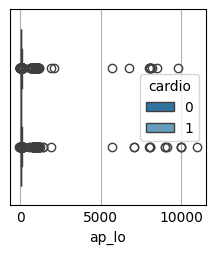

In [20]:
sns.boxplot(data=heart_data, x='ap_lo', hue='cardio')
plt.show()

In [21]:
check_outliers_no(df=heart_data, col='ap_lo')

4617

In [19]:
replace_outliers(df=heart_data, col='ap_lo')

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio,BMI
0,50.0,1,1.68,62.0,110.0,80.0,0,0,0,0,1,0,21.97
1,55.0,0,1.56,85.0,140.0,90.0,2,0,0,0,1,1,34.93
2,51.0,0,1.65,64.0,130.0,70.0,2,0,0,0,0,1,23.51
3,48.0,1,1.69,82.0,150.0,100.0,0,0,0,0,1,1,28.71
4,47.0,0,1.56,56.0,100.0,60.0,0,0,0,0,0,0,23.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...
69994,57.0,0,1.65,80.0,150.0,80.0,0,0,0,0,1,1,29.38
69996,61.0,0,1.58,126.0,140.0,90.0,1,1,0,0,1,1,50.47
69997,52.0,1,1.83,105.0,180.0,90.0,2,0,0,1,0,1,31.35
69998,61.0,0,1.63,72.0,135.0,80.0,0,1,0,0,0,1,27.10


### Outliers have been handled both on ```ap_hi``` and ```ap_lo```

In [67]:
import plotly.figure_factory as ff

grouped_data = [heart_data['ap_hi'], heart_data['ap_lo'], heart_data['age'], heart_data['height'], heart_data['weight']]
grouped_labels = ['Sytolistic', 'Diastolic', 'Age', 'Height', 'Weight']

fig = ff.create_distplot(grouped_data, grouped_labels, bin_size=[.1, 0.05, .15, .10, .10])
fig.update_layout(title = "Distribution of data fro ap_hi, ap_lo, age, height, weight")
fig.show()

<Axes: xlabel='ap_hi', ylabel='ap_lo'>

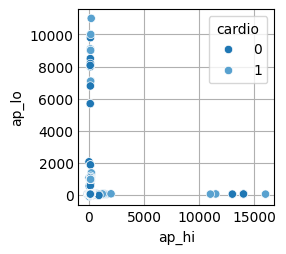

In [20]:
### Let's see the relationship between "ap_hi" and "ap_lo"

sns.scatterplot(data=heart_data, x='ap_hi', y='ap_lo', hue='cardio')

### Model Training

In [26]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, precision_recall_curve, accuracy_score, auc, roc_curve
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression

In [23]:
X = heart_data.drop("cardio", axis=1)
y = heart_data['cardio']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y, shuffle=True)

c:\Users\HP\anaconda3\envs\zidio_env\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Train score is: 71.0% 
 Test score is: 71.0%
Classification report for the model is 
              precision    recall  f1-score   support

           0       0.69      0.75      0.72      6520
           1       0.74      0.68      0.71      6839

    accuracy                           0.71     13359
   macro avg       0.72      0.71      0.71     13359
weighted avg       0.72      0.71      0.71     13359



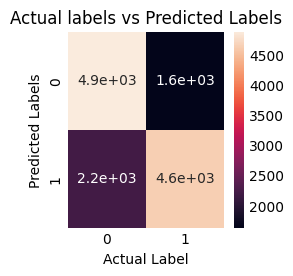

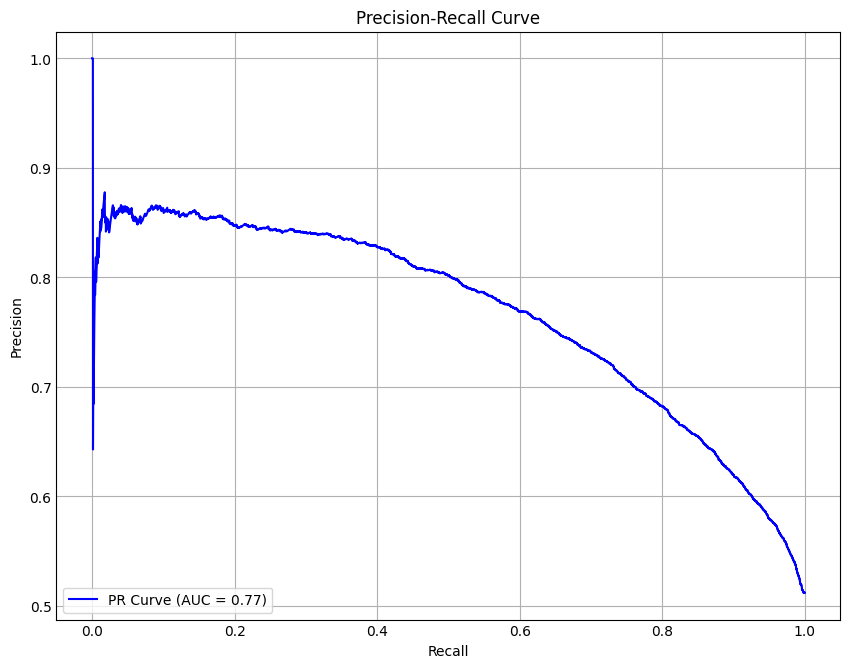

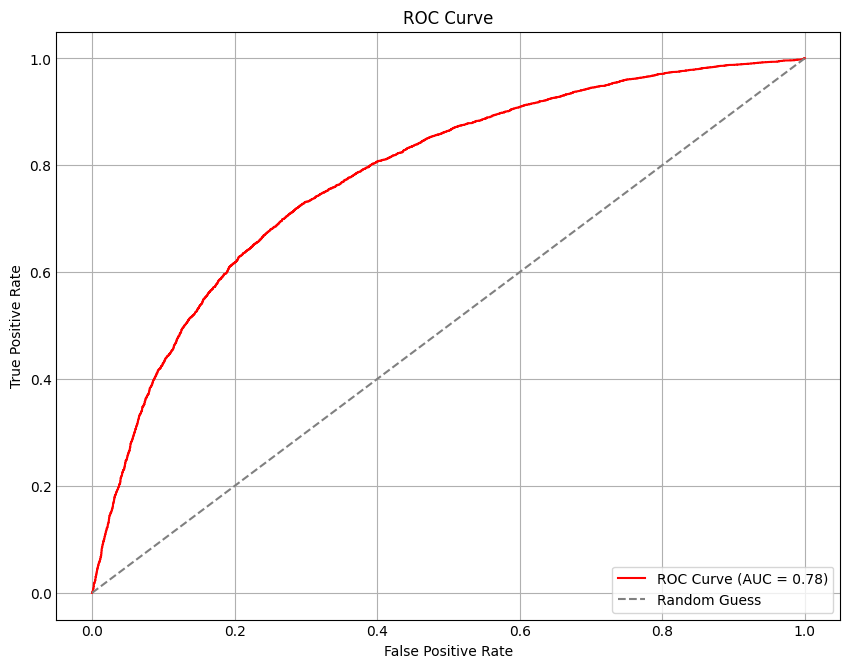

In [27]:
def model_train(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)

    train_pred = model.predict(X_train)
    test_pred = model.predict(X_test)

    test_pred_proba = model.predict_proba(X_test)[:,1]

    train_acc = accuracy_score(y_train, train_pred)
    test_acc = accuracy_score(y_test, test_pred)

    print(f"Train score is: {round(train_acc, 2)*100}% \n Test score is: {round(test_acc, 2)* 100}%")

    cf =  confusion_matrix(y_test, test_pred)
    sns.heatmap(cf, annot=True)
    plt.xlabel("Actual Label")
    plt.ylabel("Predicted Labels")
    plt.title("Actual labels vs Predicted Labels")
    plt.savefig("Confusion matrix.jpg")

    # Printing the classification report
    cfr = classification_report(y_test, test_pred)
    print(f"Classification report for the model is \n{cfr}")

    precision, recall, _ = precision_recall_curve(y_test, test_pred_proba)
    pr_auc = auc(recall, precision)

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, test_pred_proba)
    roc_auc = auc(fpr, tpr)

    # Plot Precision-Recall curve
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, label=f'PR Curve (AUC = {pr_auc:.2f})', color='b')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc='lower left')
    plt.grid(True)

    # Plot ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.2f})', color='r')
    plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='lower right')
    plt.grid(True)

    plt.show()

log_reg = LogisticRegression()
model_train(log_reg, X_train, X_test, y_train, y_test)



### Hyperparameter Tuning

In [28]:
from sklearn.model_selection import GridSearchCV

rf_model = RandomForestClassifier()

param_grid = {
    "n_estimators" : [100, 200],
    "criterion" : ["gini", 'entropy'],
    'max_depth' : [2,4]
}

grid = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, n_jobs=-1)

In [29]:
grid.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'], 'max_depth': [2, 4],
                         'n_estimators': [100, 200]})

In [30]:
grid.best_score_

0.7235603064420941

In [31]:
grid.best_params_

{'criterion': 'gini', 'max_depth': 4, 'n_estimators': 200}

Train score is: 72.0% 
 Test score is: 73.0%
Classification report for the model is 
              precision    recall  f1-score   support

           0       0.70      0.78      0.74      6520
           1       0.76      0.68      0.72      6839

    accuracy                           0.73     13359
   macro avg       0.73      0.73      0.73     13359
weighted avg       0.73      0.73      0.73     13359



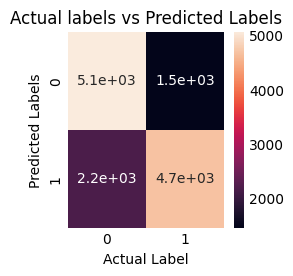

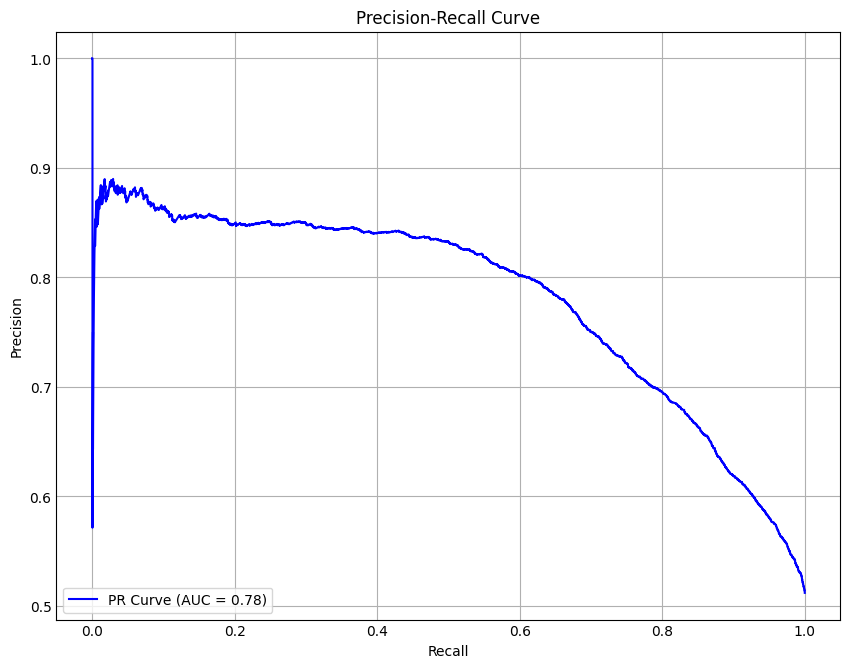

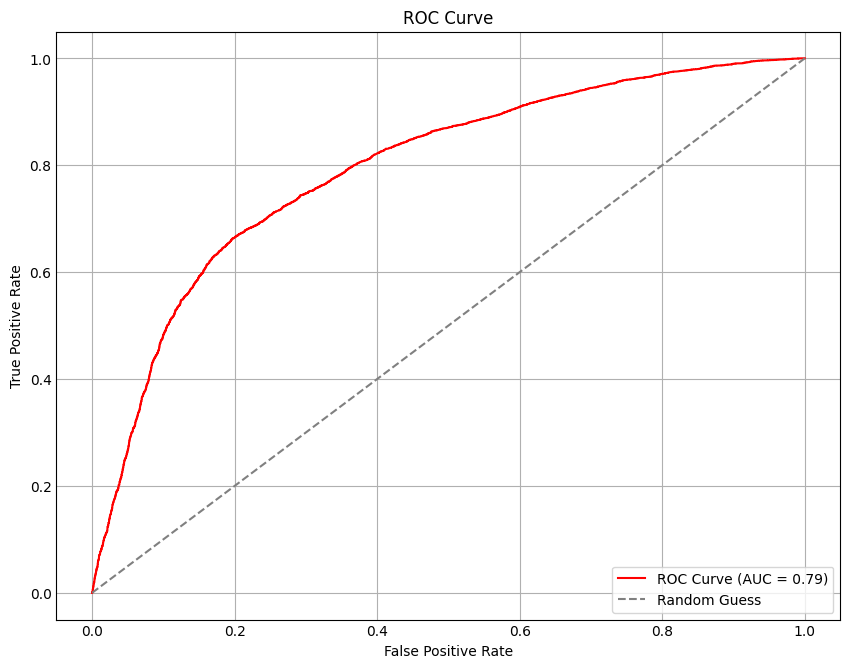

In [32]:
rf_model_2 = RandomForestClassifier(n_estimators=200, criterion='gini', max_depth=4)

model_train(model=rf_model_2, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test)